# Estimación de Arriendos de Bicicletas en la Ciudad de Londres  basado en Datos Climáticos 🚴‍♀️🌤


<center>
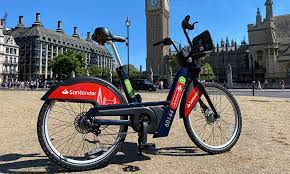
  </a>
</center>




##Carga de Datos ⏫ Data Set: London City Bike Sharing 2015-2017

In [ ]:
import pandas as pd
import requests
import json
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score
import matplotlib as mpl
from numpy.ma.core import mean
! pip install pingouin
import statsmodels.api as sm
from statsmodels.formula.api import ols
import statsmodels
from scipy import stats
from pingouin import pairwise_ttests
from pandas import json_normalize
# Se monta la unidad y se verifica
from google.colab import drive
import os
drive.mount('/content/gdrive')
#Se inicia lectura de archivo desde la ruta especificada 
%cd '/content/gdrive/MyDrive/'
nybq1= pd.read_csv('london_merged.csv',sep=';')

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 185 kB 14.3 MB/s 
     |████████████████████████████████| 9.8 MB 65.2 MB/s 
  Created wheel for pingouin: filename=pingouin-0.5.2-py3-none-any.whl size=196206 sha256=67fbccc23d888bcd6f54cc87b4922b9fb2e9650a1ad4bac96bd9888c81aa6eac
  Stored in directory: /root/.cache/pip/wheels/11/5a/63/a6d32fc26fa462c731f65480bfb98ff7bd39b8ebcb4bc6c2fe
  Created wheel for littleutils: filename=littleutils-0.2.2-py3-none-any.whl size=7048 sha256=5093d904f27b58556ccb8d99f67899ce9a9fa5e4c71c8302499c8841130eef68
  Stored in directory: /root/.cache/pip/wheels/d6/64/cd/32819b511a488e4993f2fab909a95330289c3f4e0f6ef4676d
Successfully built pingouin littleutils
  Attempting uninstall: statsmodels
    Found existing installation: statsmodels 0.12.2
    Uninstalling statsmodels-0.12.2:
      Successfully uninstalled statsmodels-0.12.2


Mounted at /content/gdrive
/content/gdrive/MyDrive


Se realiza la importacion de datos desde la URL proporcionada indicando los parámetros basícos requeridos, tales como : la Lat y Lon de la ciudad de Londres y la API Key. Adicionalemnte, agregamos el parametro opcional "Units" para que entregue los datos en formato métrico.

***Para tener en consideración: Es posible que el proveedor de datos haga cambios en el orden de las columnas que se traen a través de la API ocasionando que algunos gráficos no se generen correctamente.***

##APIS 👾

###Creacion de API Key

Ingresamos a www.openweather.org para poder capturar datos del tiempo de la ciudad de Londres.


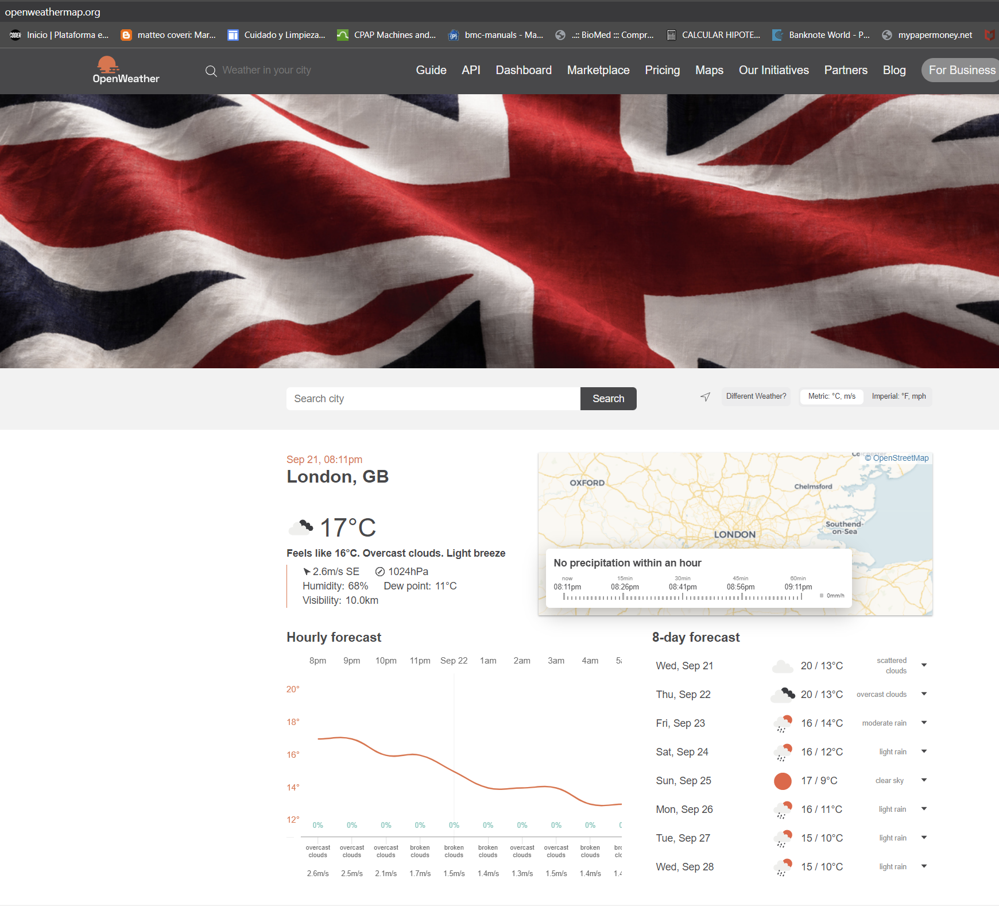

Creamos una cuenta y posterior a ello una API Key

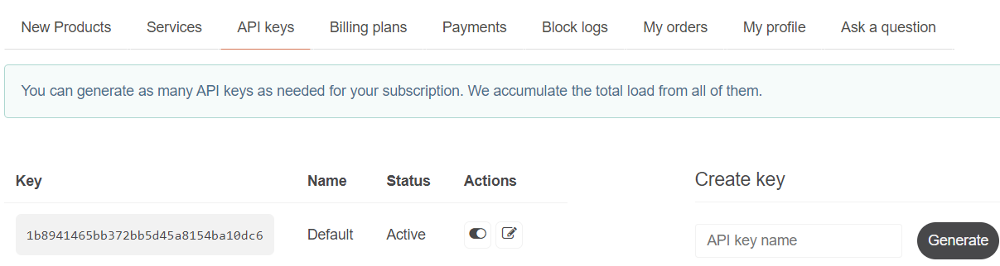

La cuenta gratuita solo permite obtener un pronóstico de 5 días en espacios de 3 horas.
Accedemos a la documentacion de la API para comprender cómo realizar la llamada a los datos.

<center>
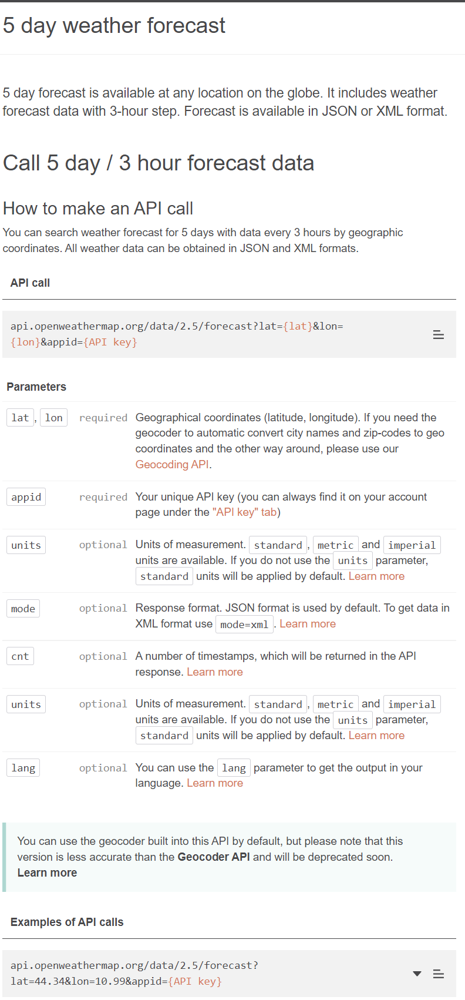
  </a>
</center>

###Carga de Datos desde la API

Se realiza la importacion de datos desde la URL proporcionada indicando los parámetros basícos requeridos, tales como : la Lat y Lon de la ciudad de Londres y la API Key. Adicionalemnte, agregamos el parametro opcional "Units" para que entregue los datos en formato métrico.

In [ ]:
url='https://api.openweathermap.org/data/2.5/forecast?lat=52.520551&lon=-0.07944&units=metric&appid=1b8941465bb372bb5d45a8154ba10dc6' #cargamos los datos desde la API
dfx= requests.get(url)
print(dfx)

<Response [200]>


Luego de obtenido satisfactoriamente un código 200 se procede a realizar la primera visualizacion de datos.

En ella revisamos la extencion en cantidad de caracteres. La cantidad de registros no es cuantioda dada la limitacion de la API con respecto a la gratuidad de la cuenta. 5 días en espacio de 3 horas implican unos 40 registros con unas 21 columnas.

In [ ]:
print(len(dfx.text))
dfx.text

16103


'{"cod":"200","message":0,"cnt":40,"list":[{"dt":1667185200,"main":{"temp":11.62,"feels_like":11.06,"temp_min":11.62,"temp_max":11.67,"pressure":1015,"sea_level":1015,"grnd_level":1015,"humidity":85,"temp_kf":-0.05},"weather":[{"id":804,"main":"Clouds","description":"overcast clouds","icon":"04n"}],"clouds":{"all":87},"wind":{"speed":4.35,"deg":190,"gust":11.67},"visibility":10000,"pop":0,"sys":{"pod":"n"},"dt_txt":"2022-10-31 03:00:00"},{"dt":1667196000,"main":{"temp":11.44,"feels_like":10.99,"temp_min":11.37,"temp_max":11.44,"pressure":1015,"sea_level":1015,"grnd_level":1014,"humidity":90,"temp_kf":0.07},"weather":[{"id":803,"main":"Clouds","description":"broken clouds","icon":"04n"}],"clouds":{"all":83},"wind":{"speed":4.11,"deg":170,"gust":9.69},"visibility":10000,"pop":0,"sys":{"pod":"n"},"dt_txt":"2022-10-31 06:00:00"},{"dt":1667206800,"main":{"temp":13.38,"feels_like":13.07,"temp_min":13.38,"temp_max":13.38,"pressure":1014,"sea_level":1014,"grnd_level":1014,"humidity":88,"temp_k

Posteriormente cargamos el texto anterior para ser visualizados en formato JSON. Como se puede apreciar existen multiples niveles dentro de la estructura lo que puede complejizar la extraccion y limpieza.

In [ ]:
texto=dfx.text
json.loads(texto)

{'cod': '200',
 'message': 0,
 'cnt': 40,
 'list': [{'dt': 1667185200,
   'main': {'temp': 11.62,
    'feels_like': 11.06,
    'temp_min': 11.62,
    'temp_max': 11.67,
    'pressure': 1015,
    'sea_level': 1015,
    'grnd_level': 1015,
    'humidity': 85,
    'temp_kf': -0.05},
   'weather': [{'id': 804,
     'main': 'Clouds',
     'description': 'overcast clouds',
     'icon': '04n'}],
   'clouds': {'all': 87},
   'wind': {'speed': 4.35, 'deg': 190, 'gust': 11.67},
   'visibility': 10000,
   'pop': 0,
   'sys': {'pod': 'n'},
   'dt_txt': '2022-10-31 03:00:00'},
  {'dt': 1667196000,
   'main': {'temp': 11.44,
    'feels_like': 10.99,
    'temp_min': 11.37,
    'temp_max': 11.44,
    'pressure': 1015,
    'sea_level': 1015,
    'grnd_level': 1014,
    'humidity': 90,
    'temp_kf': 0.07},
   'weather': [{'id': 803,
     'main': 'Clouds',
     'description': 'broken clouds',
     'icon': '04n'}],
   'clouds': {'all': 83},
   'wind': {'speed': 4.11, 'deg': 170, 'gust': 9.69},
   'visibi

Se extrae del JSON a un DataFrame por el atriburo "List"
Sin embargo se encuentran anidaciones internas

In [ ]:
df2=pd.DataFrame.from_dict(dfx.json()['list'])
df2.head()

,dt,main,weather,clouds,wind,visibility,pop,sys,dt_txt,rain
0,1667185200,"{'temp': 11.62, 'feels_like': 11.06, 'temp_min...","[{'id': 804, 'main': 'Clouds', 'description': ...",{'all': 87},"{'speed': 4.35, 'deg': 190, 'gust': 11.67}",10000,0.0,{'pod': 'n'},2022-10-31 03:00:00,NaN
1,1667196000,"{'temp': 11.44, 'feels_like': 10.99, 'temp_min...","[{'id': 803, 'main': 'Clouds', 'description': ...",{'all': 83},"{'speed': 4.11, 'deg': 170, 'gust': 9.69}",10000,0.0,{'pod': 'n'},2022-10-31 06:00:00,NaN
2,1667206800,"{'temp': 13.38, 'feels_like': 13.07, 'temp_min...","[{'id': 800, 'main': 'Clear', 'description': '...",{'all': 8},"{'speed': 5.26, 'deg': 177, 'gust': 11.16}",10000,0.0,{'pod': 'd'},2022-10-31 09:00:00,NaN
3,1667217600,"{'temp': 16.41, 'feels_like': 15.88, 'temp_min...","[{'id': 802, 'main': 'Clouds', 'description': ...",{'all': 36},"{'speed': 5.83, 'deg': 176, 'gust': 8.12}",10000,0.0,{'pod': 'd'},2022-10-31 12:00:00,NaN
4,1667228400,"{'temp': 16.17, 'feels_like': 15.57, 'temp_min...","[{'id': 803, 'main': 'Clouds', 'description': ...",{'all': 69},"{'speed': 4.14, 'deg': 149, 'gust': 7.15}",10000,0.0,{'pod': 'd'},2022-10-31 15:00:00,NaN


Utilizamos un método para poder aplicar la normalizacion correspondiente y así poder hacer que las columnas anidadas sean reconocidas.

Sin embargo el resultado no es satisfactorio dado que genera un bloque de datos dentro del mismo data frame con cada sub nivel de JSON.

In [ ]:
info = json.loads(texto) #Luego convertimos ese resultado de la normalizacion del JSON nuevamente en un Dataframe para poder observarlo mejor
df3 = json_normalize(info['list']) 
print(df3)

            dt                                            weather  visibility  \
0   1667185200  [{'id': 804, 'main': 'Clouds', 'description': ...       10000   
1   1667196000  [{'id': 803, 'main': 'Clouds', 'description': ...       10000   
2   1667206800  [{'id': 800, 'main': 'Clear', 'description': '...       10000   
3   1667217600  [{'id': 802, 'main': 'Clouds', 'description': ...       10000   
4   1667228400  [{'id': 803, 'main': 'Clouds', 'description': ...       10000   
5   1667239200  [{'id': 500, 'main': 'Rain', 'description': 'l...       10000   
6   1667250000  [{'id': 500, 'main': 'Rain', 'description': 'l...       10000   
7   1667260800  [{'id': 500, 'main': 'Rain', 'description': 'l...       10000   
8   1667271600  [{'id': 500, 'main': 'Rain', 'description': 'l...       10000   
9   1667282400  [{'id': 500, 'main': 'Rain', 'description': 'l...       10000   
10  1667293200  [{'id': 803, 'main': 'Clouds', 'description': ...       10000   
11  1667304000  [{'id': 500,

##Data Wrangling 🤠

###Descubrimiento

Luego convertimos ese resultado de la normalizacion del JSON nuevamente en un Dataframe para poder observarlo mejor

In [ ]:
df4 = pd.DataFrame(df3)
df4.head()

,dt,weather,visibility,pop,dt_txt,main.temp,main.feels_like,main.temp_min,main.temp_max,main.pressure,main.sea_level,main.grnd_level,main.humidity,main.temp_kf,clouds.all,wind.speed,wind.deg,wind.gust,sys.pod,rain.3h
0,1667185200,"[{'id': 804, 'main': 'Clouds', 'description': ...",10000,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,1015,1015,85,-0.05,87,4.35,190,11.67,n,NaN
1,1667196000,"[{'id': 803, 'main': 'Clouds', 'description': ...",10000,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,1015,1014,90,0.07,83,4.11,170,9.69,n,NaN
2,1667206800,"[{'id': 800, 'main': 'Clear', 'description': '...",10000,0.0,2022-10-31 09:00:00,13.38,13.07,13.38,13.38,1014,1014,1014,88,0.00,8,5.26,177,11.16,d,NaN
3,1667217600,"[{'id': 802, 'main': 'Clouds', 'description': ...",10000,0.0,2022-10-31 12:00:00,16.41,15.88,16.41,16.41,1013,1013,1013,68,0.00,36,5.83,176,8.12,d,NaN
4,1667228400,"[{'id': 803, 'main': 'Clouds', 'description': ...",10000,0.0,2022-10-31 15:00:00,16.17,15.57,16.17,16.17,1010,1010,1010,66,0.00,69,4.14,149,7.15,d,NaN


Nos damos cuenta que la columna que no pudo ser normalizada, contiene data que no nos es relevante:

'weather': [{'id': 500,
     'main': 'Rain',
     'description': 'light rain',
     'icon': '10d'}],

No es relevante dado que en nuestro dataset inicial tenemos principalmente: temperatura real y sensasional, humedad velocidad del viento.
Esto nos lleva a eliminar esta y otras columnas que no son de interés para nuestro objetivo.

In [ ]:
df5=df4.drop(['weather','dt','visibility','main.sea_level','main.grnd_level', 'main.temp_kf','wind.deg', 'wind.gust' ],axis=1)
df5.head()

,pop,dt_txt,main.temp,main.feels_like,main.temp_min,main.temp_max,main.pressure,main.humidity,clouds.all,wind.speed,sys.pod,rain.3h
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,4.35,n,NaN
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,4.11,n,NaN
2,0.0,2022-10-31 09:00:00,13.38,13.07,13.38,13.38,1014,88,8,5.26,d,NaN
3,0.0,2022-10-31 12:00:00,16.41,15.88,16.41,16.41,1013,68,36,5.83,d,NaN
4,0.0,2022-10-31 15:00:00,16.17,15.57,16.17,16.17,1010,66,69,4.14,d,NaN


####Correlacion

Punto explicado en el EDA

####Verificacion de Nulos

In [ ]:
sum(df5.isnull().sum())

25

In [ ]:
df5.isnull().sum()

pop                 0
dt_txt              0
main.temp           0
main.feels_like     0
main.temp_min       0
main.temp_max       0
main.pressure       0
main.humidity       0
clouds.all          0
wind.speed          0
sys.pod             0
rain.3h            25
dtype: int64

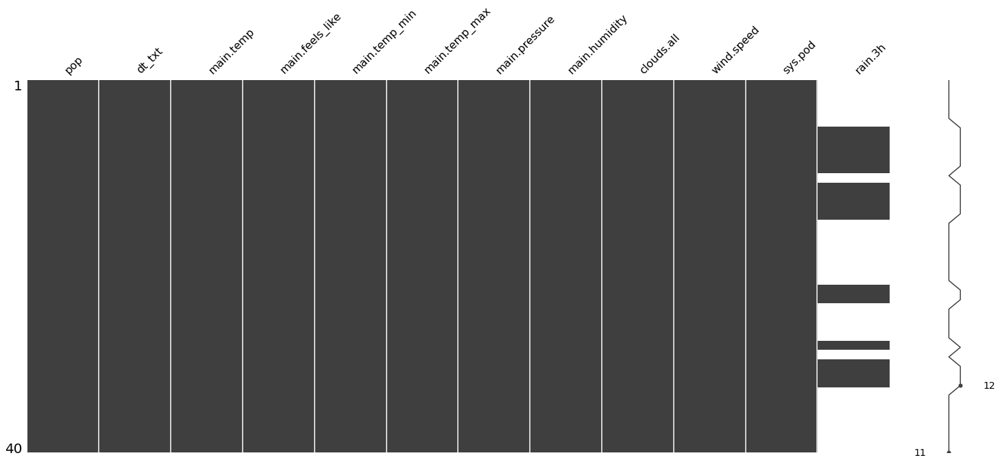

In [ ]:
import missingno as mnso 
mnso.matrix(df5)

Se puede observar que el campo rain.3h es el unico que contiene una gran cantidad de nulos (32/40).
Este campo indica la probabilidad de lluvia en un periodo de 3 horas de 0 a 1
Sin embargo, podemos iferir que los NaN no necesariamente es data faltante sino data correspondiente a la nula probabilidad de lluvia, o sea 0.
Esto nos lleva a poder realizar una sustitucion simple de NaN==>0

####Verificacion de Duplicados

In [ ]:
print(df5.shape)
df5= df5.drop_duplicates()
print(df5.shape)

(40, 12)
(40, 12)


No se encontraron duplicados

Dado que los nombres de las columnas contienen un punto (.), ciertos métodos pueden fallas, como el error siguiente. Es por eso que se ha reemplazado el punto por guión bajo. Esto se realizará de manera masiva en la etapa de estructuración.

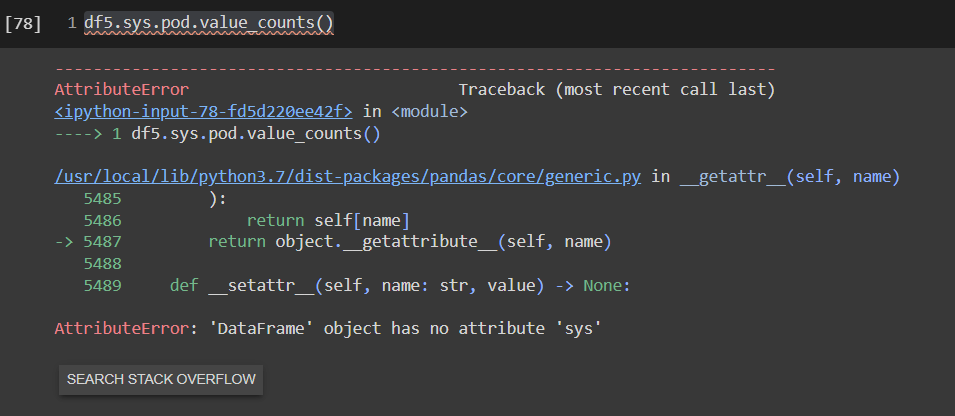

In [ ]:
df5.columns=['pop',	'dt_txt',	'temp', 'feels_like',	'temp_min',	'temp_max',	'pressure',	'humidity',	'clouds_all',	'wind_speed',	'rain_3h','sys_pod']
df5.columns

Index(['pop', 'dt_txt', 'temp', 'feels_like', 'temp_min', 'temp_max',
       'pressure', 'humidity', 'clouds_all', 'wind_speed', 'rain_3h',
       'sys_pod'],
      dtype='object')

In [ ]:
df5.sys_pod.value_counts()

0.53    2
0.25    1
0.85    1
1.20    1
0.44    1
2.96    1
0.43    1
0.40    1
0.10    1
4.13    1
2.50    1
1.13    1
3.12    1
0.34    1
Name: sys_pod, dtype: int64

Tenemos entonces que 23 de los pronósticos se refiueren a la noche y 17 al día.

###Estructuración


In [ ]:
df6= df5.copy()
df6.head()

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,rain_3h,sys_pod
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,4.35,n,NaN
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,4.11,n,NaN
2,0.0,2022-10-31 09:00:00,13.38,13.07,13.38,13.38,1014,88,8,5.26,d,NaN
3,0.0,2022-10-31 12:00:00,16.41,15.88,16.41,16.41,1013,68,36,5.83,d,NaN
4,0.0,2022-10-31 15:00:00,16.17,15.57,16.17,16.17,1010,66,69,4.14,d,NaN


####Estandarización de magnitudes

Se convierte la velocidad del viento de m/s a km/h

In [ ]:
df6['wind_speed']= (df6['wind_speed']/1000)*3600 #Se convierte la velocidad del viento de m/s a km/h
df6.head(2)

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,rain_3h,sys_pod
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,15.660,n,NaN
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,14.796,n,NaN


In [ ]:
df6.shape

(40, 12)

40 Resgistos, dado que la API en su versión gratuita entrega 5 días de pronosticos dividido en 3 horas cada uno.
Restan 12 columnas de interés las cuales son:

pop	
dt_txt	
main.temp	
main.feels_like	
main.temp_min	
main.temp_max	
main.pressure	
main.humidity	
clouds.all	
wind.speed	
sys.pod	
rain.3h

In [ ]:
df6.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 40 entries, 0 to 39
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   pop         40 non-null     float64
 1   dt_txt      40 non-null     object 
 2   temp        40 non-null     float64
 3   feels_like  40 non-null     float64
 4   temp_min    40 non-null     float64
 5   temp_max    40 non-null     float64
 6   pressure    40 non-null     int64  
 7   humidity    40 non-null     int64  
 8   clouds_all  40 non-null     int64  
 9   wind_speed  40 non-null     float64
 10  rain_3h     40 non-null     object 
 11  sys_pod     15 non-null     float64
dtypes: float64(7), int64(3), object(2)
memory usage: 4.1+ KB


Se ve que los tipos de datos están en su mayoría bien asignados. 

Se reacomodan los nombres de las columnas

In [ ]:
df6.columns=['pop',	'dt_txt',	'temp', 'feels_like',	'temp_min',	'temp_max',	'pressure',	'humidity',	'clouds_all',	'wind_speed',	'sys_pod',	'rain_3h']
df6.columns
df6.head(2)

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,sys_pod,rain_3h
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,15.660,n,NaN
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,14.796,n,NaN


###Limpieza

Según la observacion que habíamos realizado anteriormente, encontramos que los NaN no eran un error ni falta de datos, sino a que para ese registro en particula la probabilidad de lluvia era 0, por lo tanto fueron reemplazados los NaN por 0 con la funcion fillna(0).
La usamos de esta manera en todo el dataframe porque pudimos corroborar que la unica columna con NaN's era rain_3h.

In [ ]:
df6 = df6.fillna(0) # Según la observacion que habíamos realizado anteriormente, encontramos que los NaN no eran un error ni falta de datos, sino a que para ese registro en particula la probabilidad de lluvia era 0, por lo tanto fueron reemplazados los NaN por 0 con la funcion fillna(0).
#La usamos de esta manera en todo el dataframe porque pudimos corroborar que la unica columna con NaN's era rain_3h.
df6.head(2)

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,sys_pod,rain_3h
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,15.660,n,0.0
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,14.796,n,0.0


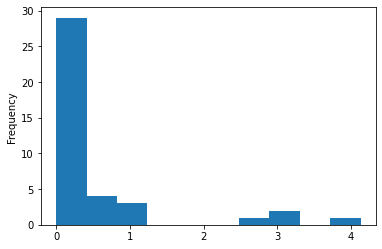

In [ ]:
df6['rain_3h'].plot(kind='hist')

Efectivamente, para esta epoca de año: Final del Verano (Otoño), el pronostico de lluvia tiende a ser bastante bajo.

###Enriquecimiento

Cargamos nuestro dataset principal

In [ ]:
nybq1.head(2)

,dateh,hour,lease,t1,t2,hum,wind_speed,weather_code,weather_code_desc,is_holiday,is_holiday_desc,is_weekend,is_weekend_desc,season_type,season_type_desc
0,25-10-2015,1:00:00,641,9.0,7.0,80.0,47.5,1,Despejado,0,No Feriado,1,FdS,2,Otono
1,17-11-2015,2:00:00,644,15.0,15.0,59.0,56.5,3,Parcialmente Nublado,0,No Feriado,0,DdS,2,Otono


De ese dataset, traemos los datos corresponientes a Otoño, dado que esa es la estacion en la que actualmente está Londres y nuestros pronosticos del tiempo que traemos desde la API son actuales.

In [ ]:
nybq2 = nybq1[nybq1['season_type_desc'] == 'Otono'] 
nybq2.head(2)

,dateh,hour,lease,t1,t2,hum,wind_speed,weather_code,weather_code_desc,is_holiday,is_holiday_desc,is_weekend,is_weekend_desc,season_type,season_type_desc
0,25-10-2015,1:00:00,641,9.0,7.0,80.0,47.5,1,Despejado,0,No Feriado,1,FdS,2,Otono
1,17-11-2015,2:00:00,644,15.0,15.0,59.0,56.5,3,Parcialmente Nublado,0,No Feriado,0,DdS,2,Otono


In [ ]:
nybq2=nybq2.drop(['weather_code','weather_code_desc','is_holiday','is_holiday_desc','is_weekend', 'is_weekend_desc','season_type'],axis=1)
nybq2.head(2)

,dateh,hour,lease,t1,t2,hum,wind_speed,season_type_desc
0,25-10-2015,1:00:00,641,9.0,7.0,80.0,47.5,Otono
1,17-11-2015,2:00:00,644,15.0,15.0,59.0,56.5,Otono


In [ ]:
df6.head(2)

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,sys_pod,rain_3h
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,15.660,n,0.0
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,14.796,n,0.0


**En este caso en particular no encontramos conjunción en la cual podamos hacer un "merge" de ambos dataframes.**

###Validacion

In [ ]:
pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     / 22.0 MB 159 kB/s
     |████████████████████████████████| 102 kB 14.2 MB/s 
     |████████████████████████████████| 690 kB 68.8 MB/s 
     |████████████████████████████████| 62 kB 63 kB/s 
     |████████████████████████████████| 4.7 MB 80.2 MB/s 
     |████████████████████████████████| 296 kB 48.1 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-3.4.0-py2.py3-none-any.whl size=315269 sha256=54fb0b28eced81ed4186fef6b6b239f6676b4a95492899e0860077ea4c4be626
  Stored in directory: /tmp/pip-ephem-wheel-cache-_of45aym/wheels/cc/d5/09/083fb07c9363a2f45854b0e3a7de7d7c560f07da74b9e9769d
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=6bd2925d251fd60f3e2a669b47e1e0ae1ba959ead28e35f219f86939131ddc68
  Stored in directory: /root/.cache/pip/wheels/70/e1/52/5b14d250ba868768823940c3229e9950d201a26d0bd3ee8655
Successfully built pandas-pro

In [ ]:
from pandas_profiling import ProfileReport
perfil=ProfileReport(df6)

In [ ]:
perfil.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
perfil2=ProfileReport(nybq2)
perfil2.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###Publicacion

In [ ]:
perfil.to_file("Reporte_Dataset_API.html")
perfil2.to_file("Reporte_Dataset_LondonBike.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

##Abstract 📖


<center>
  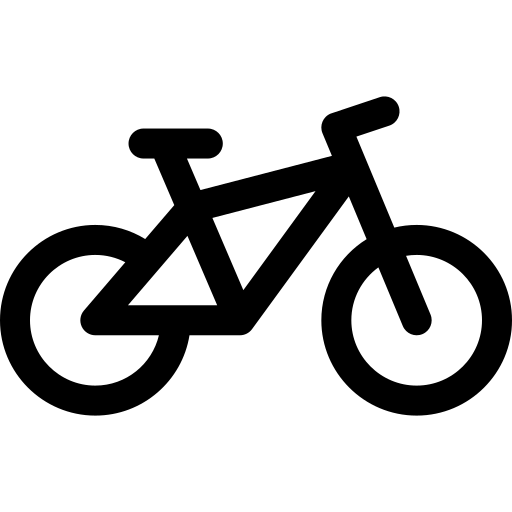

  </center>

Las bicicletas de alquiler ahorran dinero en gasolina y tarifas de estacionamiento, hacen que las ciudades sean más sostenibles y habitables. La gente usa bicicletas de alquiler para una variedad de propósitos; desde el transporte hasta el deporte. Además, el transporte en bicicleta representa el 18% del transporte total en la ciudad de Londres. Esto es gracias a la tecnología en auge que se utiliza en la industria.
El alquiler de bicicletas anima a las personas a mantenerse activas, ya que pueden hacerlo fácilmente y, al mismo tiempo, reducen los niveles de estrés causados por los estilos de vida sedentarios en la sociedad moderna. ¡Las bicicletas de alquiler se han convertido en una parte esencial de la vida Londres tiene muchas empresas de alquiler de bicicletas que funcionan principalmente en los parques y espacios públicos de la ciudad. El próspero negocio de las bicicletas se basa en bicicletas de alta tecnología, que incluyen bicicletas eléctricas, bicicletas de carga y bicicletas plegables para un fácil almacenamiento y transporte. La industria de las bicicletas genera muchos ingresos para las ciudades; Londres gana alrededor de 115 millones de libras esterlinas al año solo con el alquiler de bicicletas. 
Los datos de comportamiento de los usuarios son una herramienta esencial para las operaciones de cualquier negocio. Comprender estos datos ayuda a comprender las necesidades de los clientes y satisfacer esas necesidades creando y escalando servicios. Es por esto por lo que se hace preciso analizar los datos existentes para poder anticipar los patrones de comportamiento de los usuarios y tanto ayudar a mejorar el servicio como maximizar los ingresos.

A continuación un breve video explicativo acerca del funcionamiento de las bicicletas:
*************************************************************************
<center>
  <a href="https://youtu.be/lZv75oHhTEY" target="_blank">
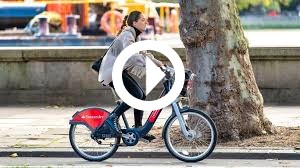
  </a>
</center>

*************************************************************************

Después de analizar los graficos y las hipótesis podemos concluir que:

1. Que tenemos evidencia suficiente para concluir el promedio de la cantidad de alquileres de viaje de las cuatro estaciones definitivamente no es igual. Y que se hace evidente entonces que el promedio de cantidad de alquileres de viaje de los usos en Verano son significativamente mayor que el promedio de la cantidad de alquileres de viaje de los usos en invierno.

2. Que hay suficiente evidencia para demostrar una diferencia que el promedio de la cantidad de alquileres de viaje de en fin de semana no esigual a que si no es fin de semana. Por lo tanto se hace evidente que el promedio de la cantidad de alquileres de viaje de Lunes a Viernes es significativamente mayor que el promedio de la cantidad de alquileres de viaje de en fin de semana.


###Descripción de Variables

A continuación de analizarán las variables para posibles utilidades de análisis.
El Data Set incluye:
 
*   🗓**"dateh"** - campo en timestamp para agrupar la información por fecha.
*   🕐**"hour"** - - campo en timestamp para agrupar la información por hora.
*   #️⃣**"lease"** - la cuenta de alquileres de bicicleta.
*   🌡**"t1"** - temperatura en celsius.
*   🌡**"t2"** - sensación térmica en celsius.
*   💧**"hum"** - porcentaje de humedad.
*   🌬**"wind_speed"** - velocidad del viento en km/h.
*   ⛱**"is_holiday"** - solo códigos: 1 feriado / 0 no feriado.
*   ⛱**"is_holiday_desc"** - 1 feriado / 0 no feriado.
*   💤**"is_weekend"** - solo códigos 1 FdS / 0 DdS.
*   💤**"is_weekend"** - 1 FdS / 0 DdS.
*   🌞**"season_type"** - Solo códigos: 0-primavera; 1-Verano; 2-Otoño; 3-Invierno.
*   🌞**"season_type_desc"** - 0-primavera; 1-Verano; 2-Otoño; 3-Invierno.
*   ☂**"weather_code"** - solo códigos: 1 = Despejado; 2 = Nubosidad Variable; 3 = Parcialmente Nublado; 4 = Nublado; 7 = Lluvia; 10 = Tormenta; 26 = Nieve
*   ☂**"weather_code_desc"** =  1 = Despejado; 2 = Nubosidad Variable; 3 = Parcialmente Nublado; 4 = Nublado; 7 = Lluvia; 10 = Tormenta; 26 = Nieve










####Detalle Básico de Variables

In [ ]:
nybq1.head()

,dateh,hour,lease,t1,t2,hum,wind_speed,weather_code,weather_code_desc,is_holiday,is_holiday_desc,is_weekend,is_weekend_desc,season_type,season_type_desc
0,25-10-2015,1:00:00,641,9.0,7.0,80.0,47.5,1,Despejado,0,No Feriado,1,FdS,2,Otono
1,17-11-2015,2:00:00,644,15.0,15.0,59.0,56.5,3,Parcialmente Nublado,0,No Feriado,0,DdS,2,Otono
2,08-02-2016,3:00:00,556,9.0,4.0,71.0,56.0,7,Lluvia,0,No Feriado,0,DdS,3,Invierno
3,28-03-2016,4:00:00,65,5.0,-2.0,87.0,54.0,7,Lluvia,1,Feriado,0,DdS,0,Primavera
4,28-03-2016,5:00:00,47,9.0,4.0,73.5,52.0,7,Lluvia,1,Feriado,0,DdS,0,Primavera


In [ ]:
nybq1.describe()

,lease,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season_type
count,17414.000000,17414.000000,17414.000000,17414.000000,17414.000000,17414.000000,17414.000000,17414.000000,17414.000000
mean,1143.101642,12.468129,11.520874,72.324730,15.915318,2.722694,0.022051,0.285403,1.492075
std,1085.108068,5.571805,6.615140,14.312815,7.897845,2.341193,0.146854,0.451619,1.118911
min,0.000000,-1.500000,-6.000000,20.500000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,257.000000,8.000000,6.000000,63.000000,10.000000,1.000000,0.000000,0.000000,0.000000
50%,844.000000,12.500000,12.500000,74.500000,15.000000,2.000000,0.000000,0.000000,1.000000
75%,1671.750000,16.000000,16.000000,83.000000,20.500000,3.000000,0.000000,1.000000,2.000000
max,7860.000000,34.000000,34.000000,100.000000,56.500000,26.000000,1.000000,1.000000,3.000000


In [ ]:
df6.head()

,pop,dt_txt,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,sys_pod,rain_3h
0,0.0,2022-10-31 03:00:00,11.62,11.06,11.62,11.67,1015,85,87,15.660,n,0.0
1,0.0,2022-10-31 06:00:00,11.44,10.99,11.37,11.44,1015,90,83,14.796,n,0.0
2,0.0,2022-10-31 09:00:00,13.38,13.07,13.38,13.38,1014,88,8,18.936,d,0.0
3,0.0,2022-10-31 12:00:00,16.41,15.88,16.41,16.41,1013,68,36,20.988,d,0.0
4,0.0,2022-10-31 15:00:00,16.17,15.57,16.17,16.17,1010,66,69,14.904,d,0.0


In [ ]:
df6.describe()

,pop,temp,feels_like,temp_min,temp_max,pressure,humidity,clouds_all,wind_speed,rain_3h
count,40.000000,40.000000,40.000000,40.00000,40.000000,40.000000,40.000000,40.000000,40.000000,40.00000
mean,0.296000,10.777500,9.173250,10.77575,10.778750,1007.800000,79.675000,64.100000,24.069600,0.47275
std,0.376119,2.791334,3.835135,2.79093,2.791732,5.598535,7.927193,31.207987,9.663871,0.98177
min,0.000000,5.670000,2.760000,5.67000,5.670000,997.000000,66.000000,1.000000,10.260000,0.00000
25%,0.000000,8.247500,5.205000,8.24750,8.247500,1003.750000,73.750000,42.500000,16.092000,0.00000
50%,0.015000,11.015000,10.050000,11.01500,11.015000,1006.000000,80.000000,68.500000,23.616000,0.00000
75%,0.612500,12.992500,12.572500,12.99250,12.992500,1013.000000,86.000000,95.750000,30.969000,0.43250
max,1.000000,16.410000,15.880000,16.41000,16.410000,1018.000000,92.000000,100.000000,44.532000,4.13000


###Objetivos 💢

####Objetivo 1️⃣

Anticipar los patrones de comportamiento de los usuarios y tanto ayudar a mejorar el servicio como maximizar los ingresos, permitiendo facilitar la toma de decisiones en cuanto a recursos y mercadeo, por medio de los datos de uso, datos feriales y clima recolectados a través del rango de tiempo comprendido entre 17-01-2015 y el 03-01-2017.

####Objetivo 2️⃣

Obtener datos del pronóstico del tiempo de la ciudad de Londres para posteriormente poder identificar patrones o hacer predicciones con respecto a los alquileres de bicicletas.

###Contexto Comercial 💲

En la actualidad en la ciudad de Londres, existen diferente empresas que prestan servicio de transporte sustentable variados, desde taxis híbridos, bicicletas y monopatines electricos hasta bicicletas comunes. Es en este ámbito donde la empresa requiere diferenciarse y entregar un servicio de calidad y orientado a cada tipo de usuario, para entregar una experiencia de viaje completa y repetible.
Este análisis permitirá abordar diferentes aristas del servicio para poder contestar aquellas interrogantes que puedan surgir para realizar las mejoras correspondientes al conjunto de elementos que intervienen.

###Problema Comercial 💢



*   El primer problema es que se reciben quejas por parte de los usuarios indicando que en ciertos horarios y espocas del año faltan bicicletas o las estaciones están llenas y no las pueden dejar.
*   Adicionalmente y como segundo problema, las campañas de mercadeo, no están teniendo los resultados esperados dado que no están siendo orientadas correctamente según la época del año, el pronótico del clima o los tipos de día si son feriados, fines de semana o día hábil.




In [ ]:
nybqX = nybq1[(nybq1.season_type_desc == 'Verano') & (nybq1.lease < 100) & (nybq1.weather_code_desc == 'Despejado')]
nybqX

,dateh,hour,lease,t1,t2,hum,wind_speed,weather_code,weather_code_desc,is_holiday,is_holiday_desc,is_weekend,is_weekend_desc,season_type,season_type_desc
2981,21-07-2015,6:00:00,86,17.0,17.0,70.5,23.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
4727,03-06-2015,0:00:00,55,13.5,13.5,69.5,20.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
5571,04-08-2015,4:00:00,71,16.0,16.0,77.0,19.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
5679,29-07-2015,16:00:00,50,12.0,12.0,77.0,19.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
5893,29-06-2015,14:00:00,78,17.0,17.0,68.0,18.5,1,Despejado,0,No Feriado,0,DdS,1,Verano
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17092,04-06-2015,5:00:00,81,12.0,12.0,67.0,3.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
17188,08-06-2016,5:00:00,76,16.0,16.0,68.0,2.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
17233,04-06-2015,2:00:00,70,11.0,11.0,77.0,2.0,1,Despejado,0,No Feriado,0,DdS,1,Verano
17347,24-08-2016,20:00:00,71,20.0,20.0,80.5,0.0,1,Despejado,0,No Feriado,0,DdS,1,Verano


De ese dataset, traemos los datos corresponientes a Otoño, dado que esa es la estacion en la que actualmente está Londres y nuestros pronosticos del tiempo que traemos desde la API son actuales.

In [ ]:
nybq2 = nybq1[nybq1['season_type_desc'] == 'Otono'] 
nybq2=nybq2.drop(['weather_code','weather_code_desc','is_holiday','is_holiday_desc','is_weekend', 'is_weekend_desc','season_type'],axis=1)
df_nybq2= nybq2.copy()
nybq2.head()

,dateh,hour,lease,t1,t2,hum,wind_speed,season_type_desc
0,25-10-2015,1:00:00,641,9.0,7.0,80.0,47.5,Otono
1,17-11-2015,2:00:00,644,15.0,15.0,59.0,56.5,Otono
5,17-11-2015,6:00:00,934,15.0,15.0,59.0,51.0,Otono
15,29-11-2015,16:00:00,885,14.0,14.0,67.0,47.0,Otono
24,29-11-2015,1:00:00,1046,14.0,14.0,67.0,46.0,Otono


###Contexto Analítico 👁‍🗨

Inicialmente se realiza un levantamiento de los cuestionamientos a partir de los problemas y el contexto, pudiendo identificar las siguientes preguntas comerciales:

*   ¿Es factible tener alguna medida, bien sea de cantidad de usos de parte de los usuarios, diferenciadas por temporada que permita ser utilizada como indicador en cuanto a las gestiones de capacidad?
*   ¿Es factible poder conocer la el uso de los usuarios en cuanto dependiendo de la temperatura, pronóstico del clima, temporada, dia u hora para poder abordar de mejor manera las campañas de mercadeo?

Luego de internalizados los problemas y el contexto se generarán visualizaciones con resúmenes numéricos junto las interpretaciones respectivas que permitan responder las hipótesis planteadas, a continuación. 

##Hipótesis ❔

###Hipótesis 1️⃣

**Hipótesis Nula**: ¿Será el promedio de la cantidad de alquileres de viaje de las cuatro estaciones iguales?

**Hipótesis de Investigación**:¿Será el promedio de cantidad de alquileres de viaje de los usos en Verano, significativamente mayor que el promedio de la cantidad de alquileres de viaje de los usos en invierno?

###Hipótesis 2️⃣

**Hipótesis Nula**: ¿Será el promedio de la cantidad de alquileres de viaje de en fin de semana igual a que si no es fin de semana?

**Hipótesis de Investigación**:¿Será el promedio de la cantidad de alquileres de viaje de Lunes a Viernes, significativamente mayor que el promedio de la cantidad de alquileres de viaje de en fin de semana?

##Análisis Exploratorio de los Datos (EDA) 🔬

###Profiling para Ánalisis Básico

####Instalacion de Librería

In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip


####Análisis Univariado

In [ ]:
from pandas_profiling import ProfileReport
profile = ProfileReport(nybq1, title='Mi resumen')
profile.to_widgets()

/usr/local/lib/python3.7/dist-packages/pandas_profiling/profile_report.py:426: UserWarning: Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60).As an alternative, you can use the HTML report. See the documentation for more information.
  "Ipywidgets is not yet fully supported on Google Colab (https://github.com/googlecolab/colabtools/issues/60)."


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
profile.to_notebook_iframe()

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

###EDA

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:18: UserWarning: Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: FutureWarning: In a future version of pandas all arguments of DataFrame.dropna will be keyword-only
  """


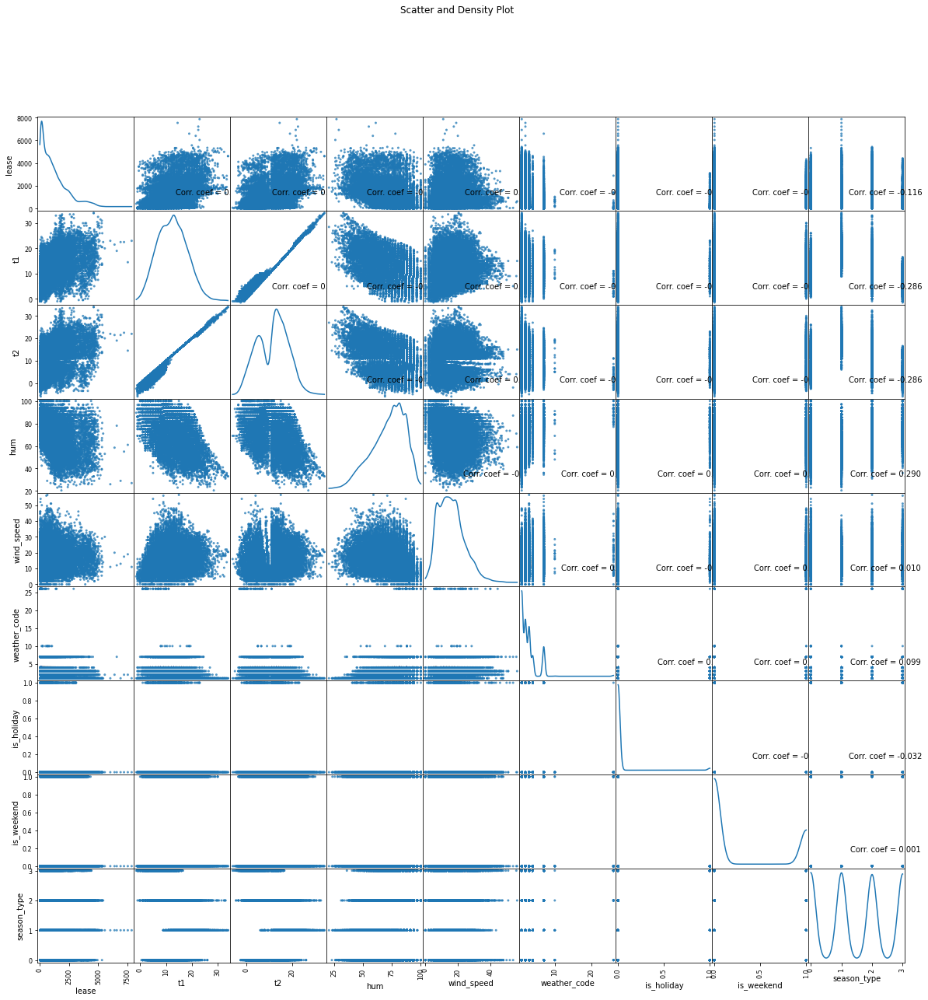

In [ ]:
# Scatter and density plots
def plotScatterMatrix(df, plotSize, textSize):
    df = df.select_dtypes(include =[np.number]) # mantener solo columnas numéricas
    # Eliminar filas y columnas que llevarían a df a ser singular
    df = df.dropna('columns')
    df = df[[col for col in df if df[col].nunique() > 1]] #mantener columnas donde hay más de 1 valores únicos
    columnNames = list(df)
    if len(columnNames) > 10: #reducir el número de columnas para la inversión de matriz de las gráficas de densidad kernel
        columnNames = columnNames[:10]
    df = df[columnNames]
    ax = pd.plotting.scatter_matrix(df, alpha=0.75, figsize=[plotSize, plotSize], diagonal='kde')
    corrs = df.corr().values
    for i, j in zip(*plt.np.triu_indices_from(ax, k = 1)):
        ax[i, j].annotate('Corr. coef = %.3f' % corrs[i, j], (0.8, 0.2), xycoords='axes fraction', ha='center', va='center', size=textSize)
    plt.suptitle('Scatter and Density Plot')
    plt.show()
df1=nybq1
df1.dataframeName = nybq1
plotScatterMatrix(nybq1, 20, 10)

Se puede observar que los arriendos por hora se concentran en aquellas con pocas cantidades, teniendo outlayer superiores a 8000, sin embargo siendo igualmente válidos. Se aprecia que estas mismas concentraciones se distribuyen en temperaturas mayores a 0°C hasta 20°C, en humedades oscilando entre el 60% y el 100% y vientos entre 0 kmph y 30 kmph. Tambien se pueden ver concentraciones inmportantes en días despejados, durante la semana. No se ven diferencias importantes entre las temporadas.

Text(0.5, 1.0, 'Correlacion de variables API')

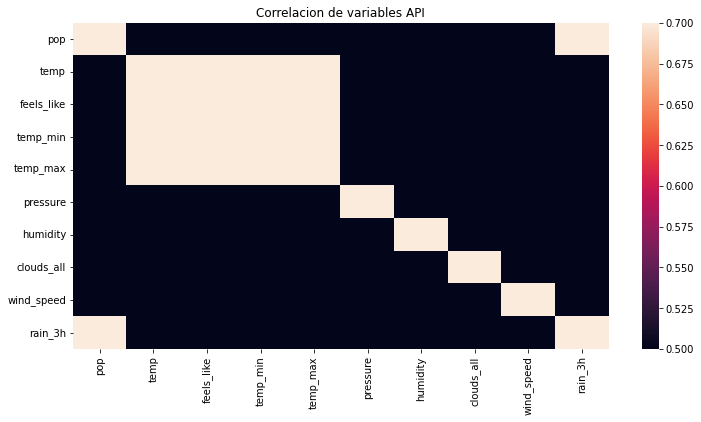

In [ ]:
plt.figure(figsize=(12,6))
sns.heatmap(df6.corr(), vmin=0.5, vmax=0.7)
plt.title("Correlacion de variables API")

En este Mapa de calor podemos observar la correlación entre las diferentes variables que nos aporta la API sobre el pronostico del clima de los próximos días. Las variables con mayor correlacion entre sí son las que su color tiende a rojo, y las de menor son las azules.

Como era de esperar las variables vinculadas a la temperatura (temperatura, sensacion térmica, temperaturas maximas y minimas) se encuentran fuertemente relacionadas entre si.

La humedad tiene una correlación negativa con las variables de temperatura, y se encuentra relativamente vinculada al pronostico de lluvia de las próximas 3 horas.

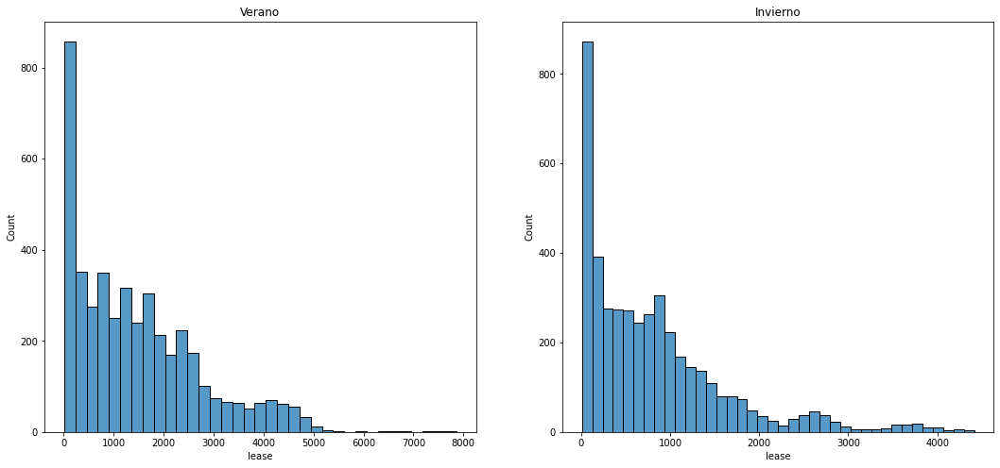

In [ ]:
verano = nybq1.query("season_type_desc == 'Verano'")
invierno = nybq1.query("season_type_desc == 'Invierno'")
plt.figure(figsize=(18,8))
plt.subplot(121)
sns.histplot(data=verano, x="lease")
plt.title("Verano");
plt.subplot(122)
sns.histplot(data=invierno, x="lease")
plt.title("Invierno");

Se tiene una mayor concentración de registros con pocos alquileres que aquellos con la mayor cantidad de alquileres por dia/hora. Esta tendendia es repetible tanto en invierno como en verano. Se puede observar que mas de 800 registros tienen entre 0 y 250 alquileres. Mientras que, por ejemplo en verano, muy pocos registros alcanzan los máximos de alquileres (+7000).

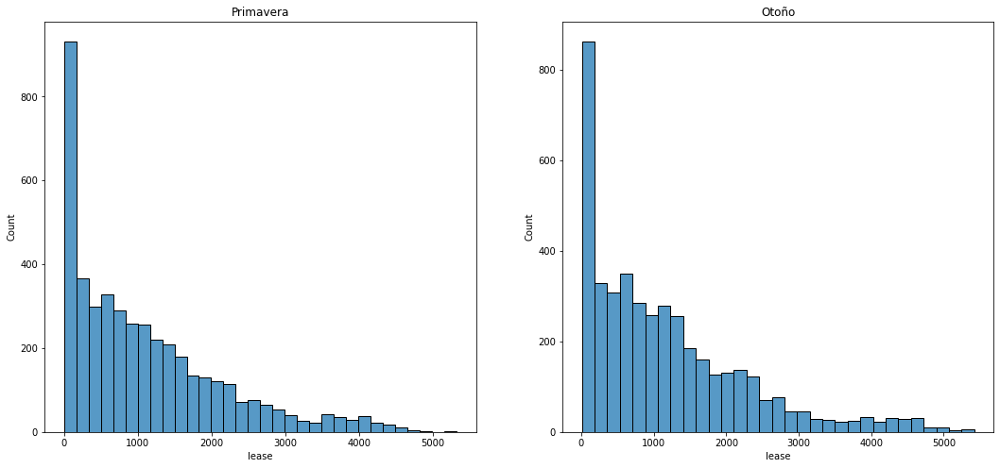

In [ ]:
primavera = nybq1.query("season_type_desc == 'Primavera'")
otono = nybq1.query("season_type_desc == 'Otono'")
plt.figure(figsize=(18,8))
plt.subplot(121)
sns.histplot(data=primavera, x="lease")
plt.title("Primavera");
plt.subplot(122)
sns.histplot(data=otono, x="lease")
plt.title("Otoño");

Se tiene una mayor concentración de registros con pocos alquileres que aquellos con la mayor cantidad de alquileres por dia/hora. Esta tendendia es repetible tanto en primavera como en Otoño. Se puede observar que mas de 800 registros tienen entre 0 y 250 alquileres. Mientras que, por ejemplo en Otoño, muy pocos registros alcanzan los máximos de alquileres (+5000).

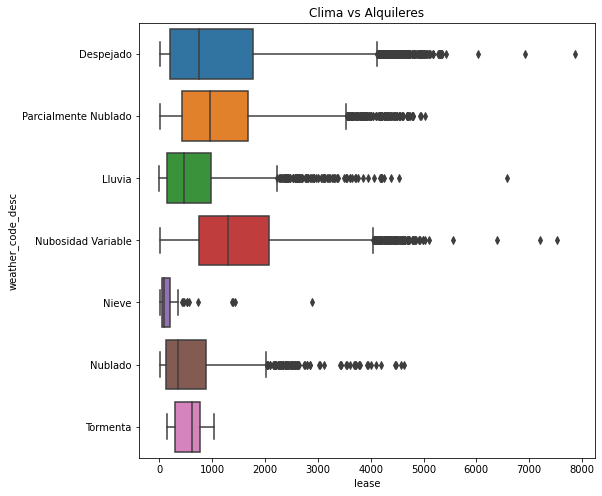

In [ ]:
plt.figure(figsize=(18,8))
plt.subplot(121)
ax = sns.boxplot(y="weather_code_desc", x="lease", data=nybq1)
plt.title("Clima vs Alquileres");


En este gráfico se puede ver que las medianas de cada tipo de clima se mantienen en un rango no muy disperso. Salvo Tormenta, todos los demás climas tienen outlayers, que como ya se indicó, son válidos, por las características de los datos y cómo son recolectados.

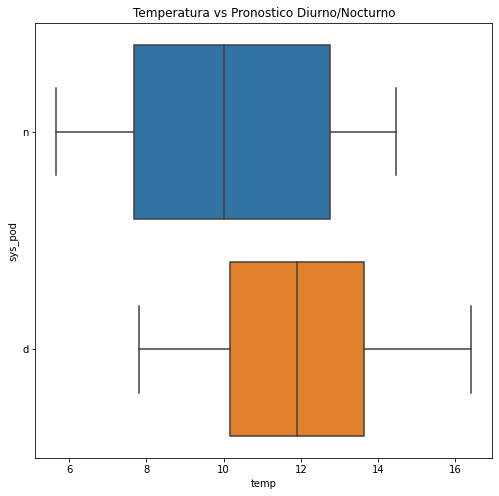

In [ ]:
plt.figure(figsize=(18,8))
plt.subplot(121)
aax = sns.boxplot(y="sys_pod", x="temp", data=df6)
plt.title("Temperatura vs Pronostico Diurno/Nocturno");

Del grafico podemos ver que la mediana de temperatura del día ronda los 16°, mientras que durante la noche alcanza los 13/14°. La amplitud termica durante el día y la noche es bastante similar, rondando los +/- 4°.

In [ ]:
df_prueba=nybq1[['lease','weather_code_desc']]
clima_test = df_prueba.groupby('weather_code_desc').agg('count')
clima_test=clima_test.rename(columns={'lease': 'Cantidad'})
clima_test

,Cantidad
weather_code_desc,
Despejado,6151
Lluvia,2141
Nieve,60
Nublado,1464
Nubosidad Variable,4033
Parcialmente Nublado,3551
Tormenta,14


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Non-1D inputs to pie() are currently squeeze()d, but this behavior is deprecated since 3.1 and will be removed in 3.3; pass a 1D array instead.
  """


Text(0.5, 1.0, 'Distribucion de Alquileres por tipo de Clima')

<Figure size 1296x576 with 0 Axes>

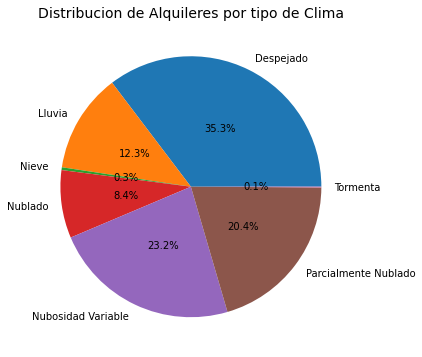

In [ ]:
plt.figure(figsize=(18,8))
#plt.subplot(121)
labels = clima_test.index
pie, ax = plt.subplots(figsize=[10,6])
fig=plt.pie(x=clima_test, autopct="%.1f%%",labels=labels, pctdistance=0.5)
plt.title("Distribucion de Alquileres por tipo de Clima", fontsize=14)

Se puede apreciar que cuando está Nublado o hay Nieve o Tormenta, los aquileres son particularmente escasos con respecto al resto de los climas.

In [ ]:
nybq31 = nybq1.copy()
nybq31['hour']=pd.to_datetime(nybq31['hour'])
nybq31['hora'] = nybq31['hour'].dt.hour

In [ ]:
nybq3x = pd.DataFrame({'count': nybq31.groupby(['season_type_desc', 'hora', 'lease']).size()})
nybq3x = nybq3x.reset_index()
nybq3x

,season_type_desc,hora,lease,count
0,Invierno,0,18,1
1,Invierno,0,25,1
2,Invierno,0,30,1
3,Invierno,0,36,1
4,Invierno,0,37,1
...,...,...,...,...
16585,Verano,23,4818,1
16586,Verano,23,4926,1
16587,Verano,23,5112,1
16588,Verano,23,5304,1


/usr/local/lib/python3.7/dist-packages/seaborn/axisgrid.py:670: UserWarning: Using the barplot function without specifying `order` is likely to produce an incorrect plot.
  warnings.warn(warning)


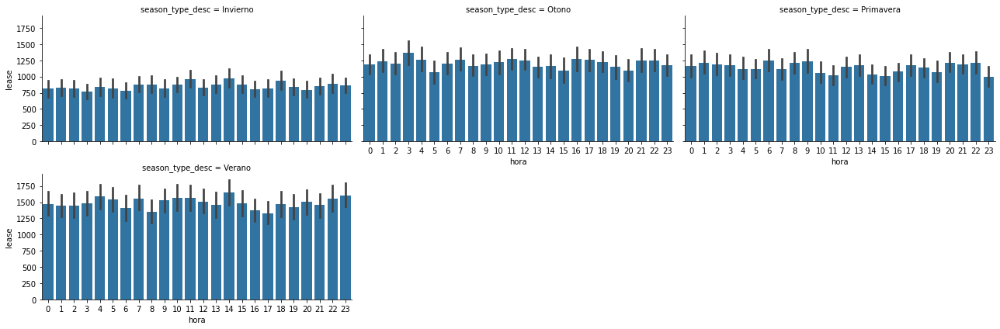

In [ ]:
chart = sns.FacetGrid(nybq3x, col='season_type_desc', margin_titles=True, col_wrap=3, aspect=2, row_order=nybq3x['season_type_desc'].unique)
chart.map(sns.barplot, 'hora', 'lease',)

En este facegrid podemos visualizar que, a través de las horas de cada una de las estaciones, exite un patron de alquiler en el que se pueden observar subidas y bajadas cada aproximadamente 2 horas. Sin embargo, sí se evidnecia una diferencia marcada en los topes de alquileres entre Invierno y Verano por ejemplo.

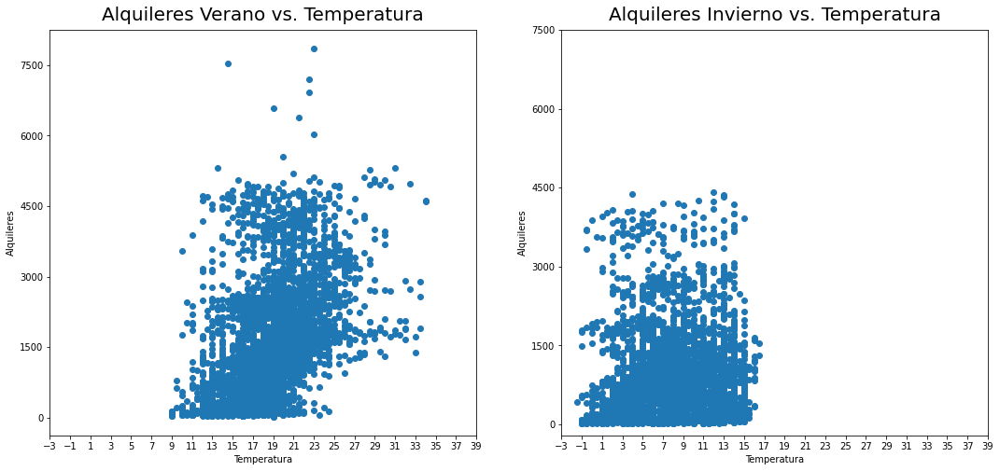

In [ ]:
verano = nybq1.query("season_type_desc == 'Verano'")
invierno = nybq1.query("season_type_desc == 'Invierno'")
plt.figure(figsize=(18,8))
plt.subplot(121)
plt.scatter(x="t1",y="lease", data=verano)
plt.title("Alquileres Verano vs. Temperatura", fontsize=20, verticalalignment='bottom');
plt.xticks(range(-3, 40, 2))
plt.yticks(range(0, 8500, 1500))
plt.ylabel("Alquileres");
plt.xlabel("Temperatura");
plt.subplot(122)
plt.scatter(x="t1",y="lease", data=invierno)
plt.title("Alquileres Invierno vs. Temperatura", fontsize=20, verticalalignment='bottom');
plt.xticks(range(-3, 40, 2))
plt.yticks(range(0, 8500, 1500))
plt.ylabel("Alquileres");
plt.xlabel("Temperatura");

En estos graficos de dispersion se puede observar que durante el invierno, donde las temperaturas oscilan entre los -1° a los 15°, la concentracion de cantidad de alquileres es menor. Si bien hay momentos donde puede haber hasta casi 4500 en una hora, en su mayoria esta concentrados entre 0 y 1500.

Durante el verano en cambio presenta una concentracion más pareja hacia arriba, teniendo picos de mas 7500 rentas en una hora. Cuando las temperaturas son más agradables, es decir, entre 15° y 25°, es cuando se dan estos picos.

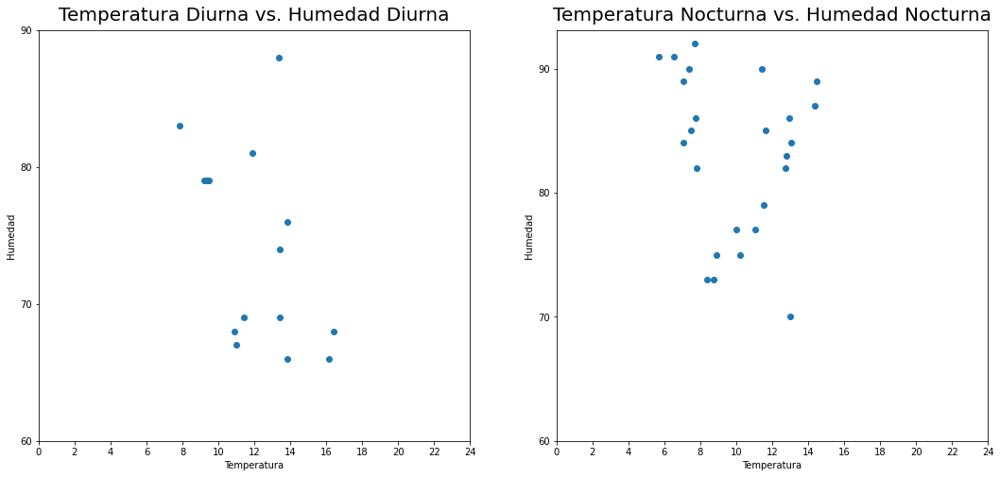

In [ ]:
dia = df6.query("sys_pod == 'd'")
noche = df6.query("sys_pod == 'n'")
plt.figure(figsize=(18,8))
plt.subplot(121)
plt.scatter(x="temp",y="humidity", data=dia)
plt.title("Temperatura Diurna vs. Humedad Diurna", fontsize=20, verticalalignment='bottom');
plt.xticks(range(0, 25, 2))
plt.yticks(range(60, 100, 10))
plt.ylabel("Humedad");
plt.xlabel("Temperatura");
plt.subplot(122)
plt.scatter(x="temp",y="humidity", data=noche)
plt.title("Temperatura Nocturna vs. Humedad Nocturna", fontsize=20, verticalalignment='bottom');
plt.xticks(range(0, 25, 2))
plt.yticks(range(60, 100, 10))
plt.ylabel("Humedad");
plt.xlabel("Temperatura");

Durante el día, a mayor temperatura tiende a bajar el porcentaje de humedad. Durante la noche no hay una tendencia observable.

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()


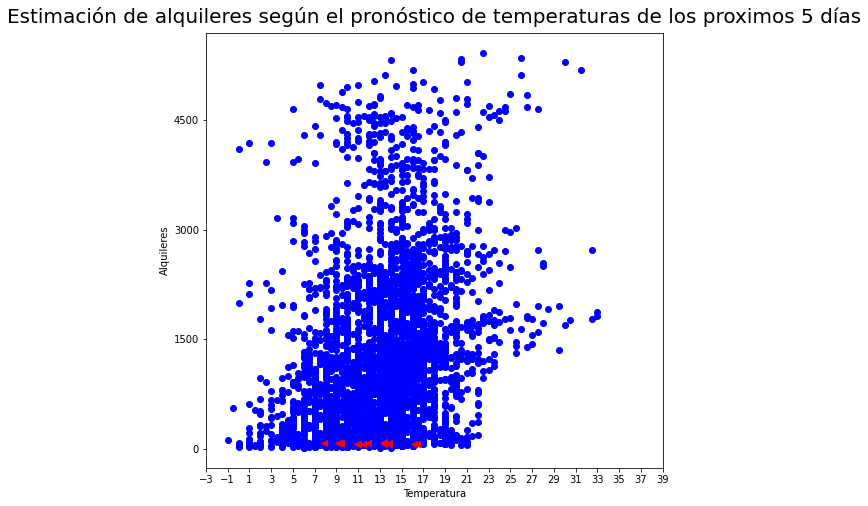

In [ ]:
otono = nybq1.query("season_type_desc == 'Otono'")
dia = df6.query("sys_pod == 'd'")
plt.figure(figsize=(18,8))
plt.subplot(121)
plt.scatter(y="lease",x="t1", data=otono, color='b')
plt.title("Alquileres Otoño vs. Temperatura", fontsize=20, verticalalignment='bottom');
plt.xticks(range(-3, 40, 2))
plt.yticks(range(0, 8500, 1500))
plt.ylabel("Alquileres");
plt.xlabel("Temperatura");
plt.subplot(121)
plt.scatter(y="humidity",x="temp", data=dia, marker='<', color='r')
plt.title("Estimación de alquileres según el pronóstico de temperaturas de los proximos 5 días", fontsize=20, verticalalignment='bottom');
plt.xticks(range(-3, 40, 2))
plt.xlabel("Temperatura");

De esta visualizacion podríamos estimar la cantidad de alquileres según el pronostico de las temperaturas de los proximos 5 días. Los triangulos rojos son las temperaturas esperadas para los proximos días, por lo que se podrían esperar picos de hasta 5000 alquileres por hora.

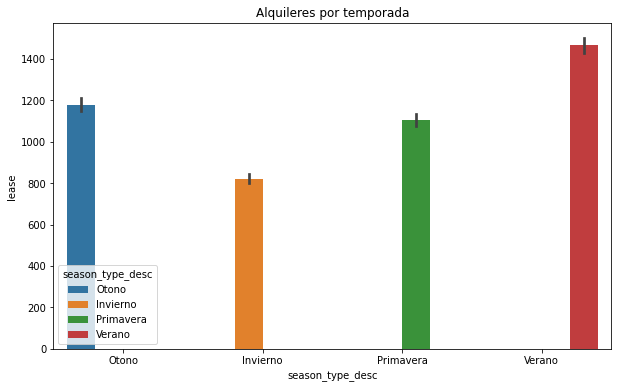

In [ ]:
plt.figure(figsize=(10,6))
sns.barplot(y='lease',x='season_type_desc', hue='season_type_desc',data=nybq1)
plt.title("Alquileres por temporada");

En este gráfico se puede apreciar que verano es la temporada con mas arriendos e invierno con la menor cantidad. las temporadas intermedias hacen de puente creciente entre ellas.

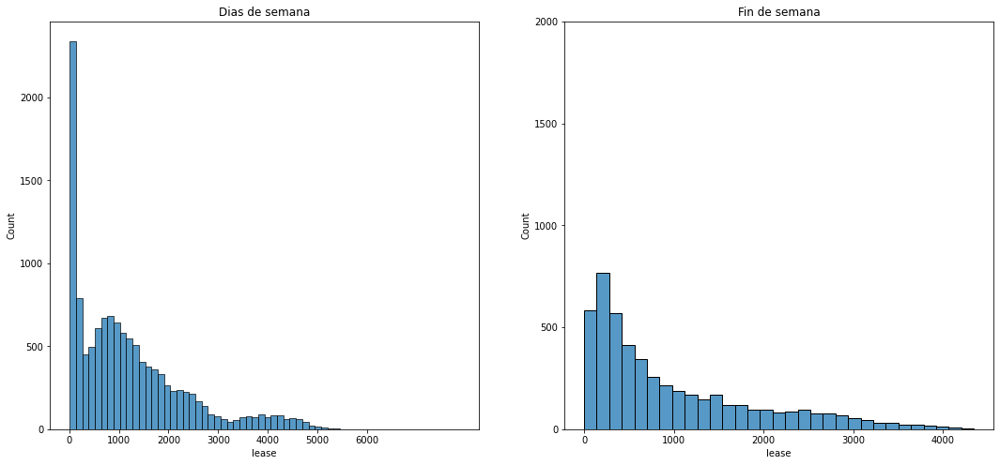

In [ ]:
dia_semana = nybq1.query("is_weekend_desc == 'DdS'")
fin_semana = nybq1.query("is_weekend_desc == 'FdS'")
plt.figure(figsize=(18,8))
plt.subplot(121)
sns.histplot(data=dia_semana, x="lease")
plt.xticks(range(0, 7000, 1000))
plt.yticks(range(0, 2500, 500))
plt.title("Dias de semana");
plt.subplot(122)
sns.histplot(data=fin_semana, x="lease")
plt.xticks(range(0, 5000, 1000))
plt.yticks(range(0, 2500, 500))
plt.title("Fin de semana");

In [ ]:
nybq1.pivot_table('lease','is_weekend_desc',aggfunc='mean')

,lease
is_weekend_desc,
DdS,1209.274831
FdS,977.415694


In [ ]:
nybq1.pivot_table('lease','is_weekend_desc',aggfunc='max')

,lease
is_weekend_desc,
DdS,7860
FdS,4341


En promedio, los dias de semana hay hasta 1209 arriendos por hora, mientras
que los fines de semana desciende a 977.
El pico de alquileres en la semana alcanza los 7860. Los sabados y domingos el maximo es de 4341 en una hora.
De la distribucion podemos comentar que los alquileres por hora tanto en los fines de semana como entre semana, presentan una asimetria positiva. En dias de semana presentan una anomalia en los primeros dos intervalos, ya que los dos primeros tocan el pico de alquileres, y luego se vuelve a observar la asimetria positiva


##Validación de Hipótesis 🧪

###Hipótesis 1️⃣

In [ ]:
nybq1.groupby(['season_type_desc'])['lease'].mean()
#data= nybq1.query("Gender_desc == 'Femenino'")
#nybq1['tripduration'].mean()

season_type_desc
Invierno      821.729099
Otono        1178.954218
Primavera    1103.831589
Verano       1464.465238
Name: lease, dtype: float64

In [ ]:
Verano=nybq1[nybq1.season_type== 1].lease
Invierno=nybq1[nybq1.season_type== 3].lease

statistic, pvalue = stats.ttest_ind(Verano,Invierno, equal_var=False)
print('Estadistico:',round(statistic,2),'p-valor:', round(pvalue,5))

Estadistico: 28.54 p-valor: 0.0


**Conclusión:** podemos concluir que el promedio de la cantidad de alquileres de viaje de las cuatro estaciones definitivamente no es igual. Se hace evidente entonces que el promedio de cantidad de alquileres de viaje de los usos en Verano son significativamente mayor que el promedio de la cantidad de alquileres de viaje de los usos en invierno.

###Hipótesis 2️⃣

In [ ]:
nybq1.groupby(['is_weekend'])['lease'].mean()

is_weekend
0    1209.274831
1     977.415694
Name: lease, dtype: float64

In [ ]:
Fds_lease=nybq1[nybq1.is_weekend_desc=='FdS'].lease
DdS_lease=nybq1[nybq1.is_weekend_desc=='DdS'].lease

statistic, pvalue = stats.ttest_ind(Fds_lease,DdS_lease, equal_var=False)
print('Estadistico:',round(statistic,2),'p-valor:', round(pvalue,5))

Estadistico: -13.96 p-valor: 0.0



**Conclusión:** podemos concluir que el el promedio de la cantidad de alquileres de viaje de en fin de semana no esigual a que si no es fin de semana. Por lo tanto se hace evidente que el promedio de la cantidad de alquileres de viaje de Lunes a Viernes es significativamente mayor que el promedio de la cantidad de alquileres de viaje de en fin de semana.

###Feature Selection: Forward Selection

In [ ]:
df1fs = nybq1.drop(['weather_code_desc', 'dateh', 'hour','is_holiday_desc','is_weekend_desc','season_type_desc'], axis=1)
df1fs.head()

,lease,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season_type
0,641,9.0,7.0,80.0,47.5,1,0,1,2
1,644,15.0,15.0,59.0,56.5,3,0,0,2
2,556,9.0,4.0,71.0,56.0,7,0,0,3
3,65,5.0,-2.0,87.0,54.0,7,1,0,0
4,47,9.0,4.0,73.5,52.0,7,1,0,0


In [ ]:
dffs = pd.DataFrame(df1fs)
dffs['lease'] = pd.Series(dffs.lease)
X = dffs.drop("lease", 1)       # feature matrix
y = dffs['lease']               # target feature
dffs.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  This is separate from the ipykernel package so we can avoid doing imports until


,lease,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season_type
0,641,9.0,7.0,80.0,47.5,1,0,1,2
1,644,15.0,15.0,59.0,56.5,3,0,0,2
2,556,9.0,4.0,71.0,56.0,7,0,0,3
3,65,5.0,-2.0,87.0,54.0,7,1,0,0
4,47,9.0,4.0,73.5,52.0,7,1,0,0


In [ ]:
X

,t1,t2,hum,wind_speed,weather_code,is_holiday,is_weekend,season_type
0,9.0,7.0,80.0,47.5,1,0,1,2
1,15.0,15.0,59.0,56.5,3,0,0,2
2,9.0,4.0,71.0,56.0,7,0,0,3
3,5.0,-2.0,87.0,54.0,7,1,0,0
4,9.0,4.0,73.5,52.0,7,1,0,0
...,...,...,...,...,...,...,...,...
17409,1.5,1.5,75.5,0.0,1,0,0,3
17410,1.0,1.0,93.0,0.0,1,0,0,3
17411,1.0,1.0,81.0,0.0,1,0,0,3
17412,0.0,0.0,80.0,0.0,1,0,0,3


In [ ]:
y

0         641
1         644
2         556
3          65
4          47
         ... 
17409     833
17410      33
17411     110
17412    3887
17413      25
Name: lease, Length: 17414, dtype: int64

In [ ]:
import statsmodels.api as sm
def forward_selection(data, target, significance_level=0.01):
    initial_features = data.columns.tolist()
    best_features = []
    while (len(initial_features)>0):
        remaining_features = list(set(initial_features)-set(best_features))
        new_pval = pd.Series(index=remaining_features)
        for new_column in remaining_features:
            model = sm.OLS(target, sm.add_constant(data[best_features+[new_column]])).fit()
            new_pval[new_column] = model.pvalues[new_column]
        min_p_value = new_pval.min()
        if(min_p_value<significance_level):
            best_features.append(new_pval.idxmin())
        else:
            break
    return best_features

In [ ]:
forward_selection(X,y)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  import sys
/usr/local/lib/python3.7/dis

['t1',
 'hum',
 'is_weekend',
 'season_type',
 'is_holiday',
 'wind_speed',
 'weather_code']

##Conclusiones Técnicas 💯

In [ ]:
import sys
import joblib
sys.modules['sklearn.externals.joblib'] = joblib

In [ ]:
#Librerias
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
from sklearn.linear_model import LinearRegression
# Sequential Forward Selection(sfs)
sfs = SFS(LinearRegression(),
          k_features=7,
          forward=True,
          floating=False,
          scoring = 'r2',
          cv = 0)

In [ ]:
sfs.fit(X, y)
sfs.k_feature_names_     #Lista final de features

('t1',
 'hum',
 'wind_speed',
 'weather_code',
 'is_holiday',
 'is_weekend',
 'season_type')

In [ ]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=2)
from sklearn.linear_model import LinearRegression
# crear el modelo
lr = LinearRegression()
# Ajustar el modelo con X_train y y_train
lr.fit(X_train,y_train)
# PRedecir con X_test
y_pred = lr.predict(X_test)

In [ ]:
from sklearn.metrics import mean_absolute_error
print("MAE",mean_absolute_error(y_test,y_pred))

MAE 696.8472541046413


In [ ]:
nybq1.lease.max()


7860

In [ ]:
nybq1.lease.min()

0

**Este modelo tiene un error promedio de 696 alquileres de bicis. El rango de cantidad de alquileres va entre 0 y 7860**

In [ ]:
from sklearn.metrics import mean_squared_error
print("MSE",mean_squared_error(y_test,y_pred))

MSE 906411.6654476894


In [ ]:
print("RMSE",np.sqrt(mean_squared_error(y_test,y_pred)))

RMSE 952.056545299537


**El modelo tiene un error en promedio de +/- 952 alquileres de bicis.**

In [ ]:
print("RMSE",np.log(np.sqrt(mean_squared_error(y_test,y_pred))))

RMSE 6.858624429350517


In [ ]:
from sklearn.metrics import r2_score
r2 = r2_score(y_test,y_pred)
print(r2)

0.25555782028241036


**Dado que R2 es cercano a 0 podemos concluir que el modelo propuesto no mejora la predicción sobre el modelo medido.**

##Recomendaciones con base en insights observados ✅

De los insights recopilados y analizados se pueden desprender las siguientes conclusiones y recomendaciones:


*   Las campañas de mercadeo deben ser orientadas por factores que impliquen la temporada. IntensificandManteniendo o aumentando los esfuerzos en Verano e imprimiendo más campaña en Invierno y temporadas intermedias.
*   Se recomienda mantener las campañas de mercadeo a usuarios durante los días de semana, e intensificar y promover el uso durante los fines de semana.





